In [ ]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [1]:
#INSTALL DEPENDENCIES
!pip install -q datasets kornia torchmetrics torchvision safetensors huggingface_hub opencv-python

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 43.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 983.2/983.2 kB 33.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.0/3.0 MB 76.9 MB/s eta 0:00:00


In [3]:
#Install LPIPS
!pip install -q lpips

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.8/53.8 kB 3.2 MB/s eta 0:00:00


In [4]:
# IMPORTS
import os
import glob
import cv2
import numpy as np
import torch
import matplotlib.pyplot as plt
from zipfile import ZipFile
from torch.utils.data import Dataset, DataLoader
from kornia.color import rgb_to_lab, lab_to_rgb
import torchmetrics
from safetensors.torch import load_file
from huggingface_hub import hf_hub_download

import torch.nn as nn
import torch.optim as optim
from torchmetrics import PeakSignalNoiseRatio, StructuralSimilarityIndexMeasure

import lpips
from torchmetrics import MeanAbsoluteError

In [5]:
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
print("Using device:", DEVICE)

Using device: cuda


In [6]:
REPO_ID = "ayushshah/imagecolorization"
model_py_path = hf_hub_download(repo_id=REPO_ID, filename="model.py", local_dir=".", local_dir_use_symlinks=False)
weights_path = hf_hub_download(repo_id=REPO_ID, filename="model.safetensors", local_dir=".", local_dir_use_symlinks=False)

from model import UNet
model = UNet().to(DEVICE)
state_dict = load_file(weights_path)
model.load_state_dict(state_dict)
print("✅ Pretrained model loaded")

/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/huggingface_hub/file_download.py:979: UserWarning: `local_dir_use_symlinks` parameter is deprecated and will be ignored. The process to download files to a local folder has been updated and do not rely on symlinks anymore. You only need to pass a destination folder as`local_dir`.
For more details, check out https://huggingface.co/docs/huggingface_hub/main/en/guides/download#download-files-to-local-folder.
  warnings.warn(


model.py: 0.00B [00:00, ?B/s]

model.safetensors:   0%|          | 0.00/98.2M [00:00<?, ?B/s]

Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth


100%|██████████| 83.3M/83.3M [00:01<00:00, 59.5MB/s]


✅ Pretrained model loaded


In [8]:
# DOWNLOAD LANDSCAPE DATASET
DS_PATH = './dataset/landscape-pictures'
COLOR_PATH = os.path.join(DS_PATH, 'color')
os.makedirs(DS_PATH, exist_ok=True)

!curl -L "https://www.kaggle.com/api/v1/datasets/download/arnaud58/landscape-pictures" -o ./dataset/landscape-pictures.zip
with ZipFile('./dataset/landscape-pictures.zip', 'r') as zip_ref:
  zip_ref.extractall(DS_PATH)

os.makedirs(COLOR_PATH, exist_ok=True)
for f in sorted(glob.glob(os.path.join(DS_PATH, '*.jpg'))):
  new_path = os.path.join(COLOR_PATH, os.path.basename(f))
  if not os.path.exists(new_path):
    os.rename(f, new_path)

color_files = sorted(glob.glob(os.path.join(COLOR_PATH, '*.jpg')))
np.random.seed(42)
np.random.shuffle(color_files)


MAX_SAMPLES = 2500
color_files = color_files[:MAX_SAMPLES]

train_files = color_files[:1750]
val_files   = color_files[1750:2125]
test_files  = color_files[2125:2500]

print(f"Train: {len(train_files)}, Val: {len(val_files)}, Test: {len(test_files)}")


  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100  620M  100  620M    0     0  21.2M      0  0:00:29  0:00:29 --:--:-- 21.7M
Train: 1750, Val: 375, Test: 375


In [9]:
#LANDSCAPE DATASET CLASS
class LandscapeDataset(Dataset):
    def __init__(self, file_list, target_size=(224, 224), ab_scale=0.5):
        self.file_list = file_list
        self.target_size = target_size
        self.ab_scale = ab_scale

    def __len__(self):
        return len(self.file_list)

    def __getitem__(self, idx):
        img = cv2.imread(self.file_list[idx])
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, self.target_size)
        img = img.astype(np.float32) / 255.0

        # Convert to Lab
        lab = rgb_to_lab(torch.tensor(img).permute(2, 0, 1).unsqueeze(0)).squeeze(0)
        L = lab[0:1] / 100.0          # [0,1]
        ab = lab[1:3] / 128.0 * self.ab_scale  # scaled ab

        return L.float(), ab.float()

# I must use same input size as pretrained model (224x224)
TARGET_SIZE = (224, 224)
AB_SCALE = 0.5
BATCH_SIZE = 8

train_ds = LandscapeDataset(train_files, TARGET_SIZE, AB_SCALE)
val_ds   = LandscapeDataset(val_files, TARGET_SIZE, AB_SCALE)
test_ds  = LandscapeDataset(test_files, TARGET_SIZE, AB_SCALE)

train_loader = DataLoader(train_ds, batch_size=BATCH_SIZE, shuffle=True, num_workers=2)
val_loader   = DataLoader(val_ds, batch_size=BATCH_SIZE, shuffle=False, num_workers=2)
test_loader  = DataLoader(test_ds, batch_size=BATCH_SIZE, shuffle=False, num_workers=2)

In [10]:
def visualize_image(model, dataset, idx, device=DEVICE):
    model.eval()
    plt.figure(figsize=(12, 4))

    with torch.no_grad():
        L, ab = dataset[idx]
        L = L.unsqueeze(0).to(device)
        ab = ab.unsqueeze(0).to(device)

        pred_ab = model(L)

        # Lab reconstruction
        lab_pred = torch.cat([ L * 100.0, pred_ab * (128.0 / AB_SCALE)], dim=1)

        lab_gt = torch.cat([L * 100.0, ab * (128.0 / AB_SCALE)], dim=1)

        rgb_pred = lab_to_rgb(lab_pred).squeeze(0).permute(1, 2, 0).cpu().numpy()
        rgb_gt   = lab_to_rgb(lab_gt).squeeze(0).permute(1, 2, 0).cpu().numpy()
        L_gray   = L.squeeze().cpu().numpy()

        plt.subplot(1, 3, 1)
        plt.imshow(L_gray, cmap="gray")
        plt.title(f"Input L (idx={idx})")
        plt.axis("off")

        plt.subplot(1, 3, 2)
        plt.imshow(np.clip(rgb_pred, 0, 1))
        plt.title("Predicted")
        plt.axis("off")

        plt.subplot(1, 3, 3)
        plt.imshow(np.clip(rgb_gt, 0, 1))
        plt.title("Ground Truth")
        plt.axis("off")

    plt.show()

In [11]:
#loss
criterion = nn.SmoothL1Loss()

# Metrics
psnr_metric = PeakSignalNoiseRatio().to(DEVICE)
ssim_metric = StructuralSimilarityIndexMeasure(data_range=1.0).to(DEVICE)

# Optimizer
optimizer = optim.Adam(model.parameters(), lr=1e-4)

# CHECKPOINT DIR
DRIVE_DIR = "/content/drive/MyDrive/colorization_models"
os.makedirs(DRIVE_DIR, exist_ok=True)

/usr/local/lib/python3.12/dist-packages/torchmetrics/utilities/prints.py:62: FutureWarning: Importing `PeakSignalNoiseRatio` from `torchmetrics` was deprecated and will be removed in 2.0. Import `PeakSignalNoiseRatio` from `torchmetrics.image` instead.
  _future_warning(
/usr/local/lib/python3.12/dist-packages/torchmetrics/utilities/prints.py:62: FutureWarning: Importing `StructuralSimilarityIndexMeasure` from `torchmetrics` was deprecated and will be removed in 2.0. Import `StructuralSimilarityIndexMeasure` from `torchmetrics.image` instead.
  _future_warning(


In [12]:
# MAE (pixel-level)
mae_metric = MeanAbsoluteError().to(DEVICE)

# LPIPS (perceptual)
lpips_metric = lpips.LPIPS(net='alex').to(DEVICE)
lpips_metric.eval()

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Downloading: "https://download.pytorch.org/models/alexnet-owt-7be5be79.pth" to /root/.cache/torch/hub/checkpoints/alexnet-owt-7be5be79.pth


100%|██████████| 233M/233M [00:01<00:00, 201MB/s]


Loading model from: /usr/local/lib/python3.12/dist-packages/lpips/weights/v0.1/alex.pth


LPIPS(
  (scaling_layer): ScalingLayer()
  (net): alexnet(
    (slice1): Sequential(
      (0): Conv2d(3, 64, kernel_size=(11, 11), stride=(4, 4), padding=(2, 2))
      (1): ReLU(inplace=True)
    )
    (slice2): Sequential(
      (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
      (3): Conv2d(64, 192, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
      (4): ReLU(inplace=True)
    )
    (slice3): Sequential(
      (5): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
      (6): Conv2d(192, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (7): ReLU(inplace=True)
    )
    (slice4): Sequential(
      (8): Conv2d(384, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (9): ReLU(inplace=True)
    )
    (slice5): Sequential(
      (10): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (11): ReLU(inplace=True)
    )
  )
  (lin0): NetLinLayer(
    (model): Sequential(
      (0): D

In [13]:
def delta_e(rgb1, rgb2):
    lab1 = rgb_to_lab(rgb1)
    lab2 = rgb_to_lab(rgb2)
    return torch.mean(torch.sqrt(torch.sum((lab1 - lab2) ** 2, dim=1)))

In [14]:
def train_model(model, train_loader, val_loader, criterion, optimizer,
                device=DEVICE, epochs=10, patience=10):

    save_path = os.path.join(DRIVE_DIR, "best_model.pth")

    best_val_loss = float('inf')
    patience_counter = 0

    train_losses = []
    val_losses = []

    for epoch in range(1, epochs + 1):
        # here we do the training
        model.train()
        train_loss = 0.0

        for L, ab in train_loader:
            L, ab = L.to(device), ab.to(device)
            optimizer.zero_grad()

            output = model(L)
            loss = criterion(output, ab)
            loss.backward()
            optimizer.step()

            train_loss += loss.item() * L.size(0)

        train_loss /= len(train_loader.dataset)

        # here is the evaluation
        model.eval()
        val_loss = 0.0
        psnr_total = 0.0
        ssim_total = 0.0

        with torch.no_grad():
            for L, ab in val_loader:
                L, ab = L.to(device), ab.to(device)
                output = model(L)

                loss = criterion(output, ab)
                val_loss += loss.item() * L.size(0)

                lab_pred = torch.cat([L * 100.0, output * (128.0 * AB_SCALE)], dim=1)
                lab_gt   = torch.cat([L * 100.0, ab * (128.0 * AB_SCALE)], dim=1)

                rgb_pred = lab_to_rgb(lab_pred)
                rgb_gt   = lab_to_rgb(lab_gt)

                psnr_total += psnr_metric(rgb_pred, rgb_gt) * L.size(0)
                ssim_total += ssim_metric(rgb_pred, rgb_gt) * L.size(0)

        val_loss /= len(val_loader.dataset)
        psnr_total /= len(val_loader.dataset)
        ssim_total /= len(val_loader.dataset)

        # ✅ STORE LOSSES
        train_losses.append(train_loss)
        val_losses.append(val_loss)

        print(f"Epoch {epoch}/{epochs} | "
              f"Train Loss: {train_loss:.4f} | Val Loss: {val_loss:.4f} | "
              f"PSNR: {psnr_total:.2f} | SSIM: {ssim_total:.4f}")

        #early stopping
        if val_loss < best_val_loss:
            best_val_loss = val_loss
            patience_counter = 0
            torch.save(model.state_dict(), save_path)
            print(f"✅ Best model saved at epoch {epoch}")
        else:
            patience_counter += 1
            if patience_counter >= patience:
                print(f"⚠️ Early stopping triggered at epoch {epoch}")
                break

    print(f"Training complete! Best model saved at {save_path}")
    return train_losses, val_losses

In [15]:
train_losses, val_losses =train_model(model, train_loader, val_loader, criterion, optimizer,epochs=40, patience=15)

Epoch 1/40 | Train Loss: 0.0017 | Val Loss: 0.0013 | PSNR: 44.14 | SSIM: 0.9960
✅ Best model saved at epoch 1
Epoch 2/40 | Train Loss: 0.0014 | Val Loss: 0.0013 | PSNR: 44.20 | SSIM: 0.9961
✅ Best model saved at epoch 2
Epoch 3/40 | Train Loss: 0.0014 | Val Loss: 0.0013 | PSNR: 44.30 | SSIM: 0.9961
✅ Best model saved at epoch 3
Epoch 4/40 | Train Loss: 0.0013 | Val Loss: 0.0012 | PSNR: 44.46 | SSIM: 0.9965
✅ Best model saved at epoch 4
Epoch 5/40 | Train Loss: 0.0013 | Val Loss: 0.0012 | PSNR: 44.58 | SSIM: 0.9962
✅ Best model saved at epoch 5
Epoch 6/40 | Train Loss: 0.0013 | Val Loss: 0.0012 | PSNR: 44.58 | SSIM: 0.9962
✅ Best model saved at epoch 6
Epoch 7/40 | Train Loss: 0.0013 | Val Loss: 0.0012 | PSNR: 44.68 | SSIM: 0.9964
✅ Best model saved at epoch 7
Epoch 8/40 | Train Loss: 0.0013 | Val Loss: 0.0012 | PSNR: 44.47 | SSIM: 0.9964
Epoch 9/40 | Train Loss: 0.0012 | Val Loss: 0.0012 | PSNR: 44.63 | SSIM: 0.9962
Epoch 10/40 | Train Loss: 0.0012 | Val Loss: 0.0012 | PSNR: 44.54 | SS

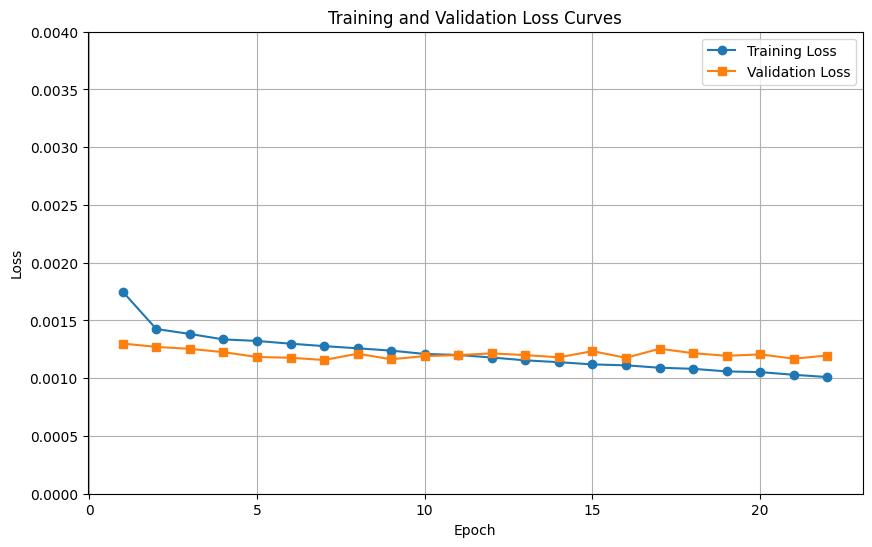

In [16]:
import matplotlib.pyplot as plt
import numpy as np

def plot_loss_curves(train_losses, val_losses, save_path=None):
    epochs = range(1, len(train_losses) + 1)

    plt.figure(figsize=(10, 6))
    plt.plot(epochs, train_losses, label="Training Loss", marker='o')
    plt.plot(epochs, val_losses, label="Validation Loss", marker='s')
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.title("Training and Validation Loss Curves")
    plt.legend()
    plt.grid(True)

    y_ticks = np.arange(0, 0.0045, 0.0005)
    plt.yticks(y_ticks)

    if save_path:
        plt.savefig(save_path, dpi=300)
    plt.show()

plot_loss_curves(train_losses, val_losses, save_path="loss_curve.png")

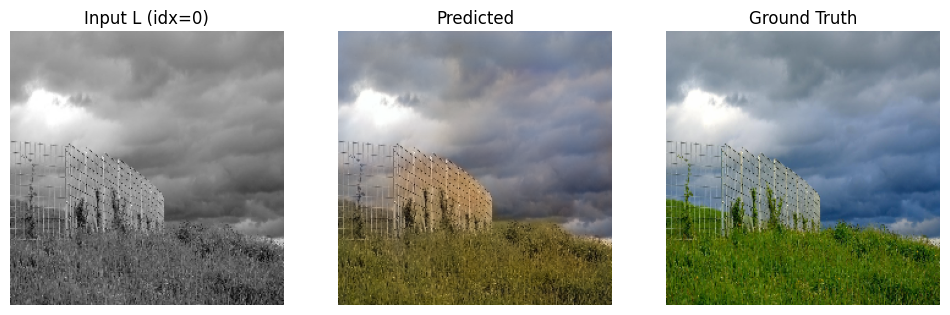

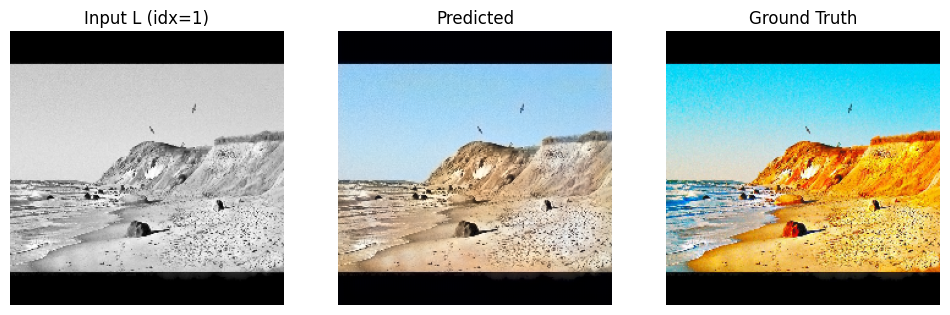

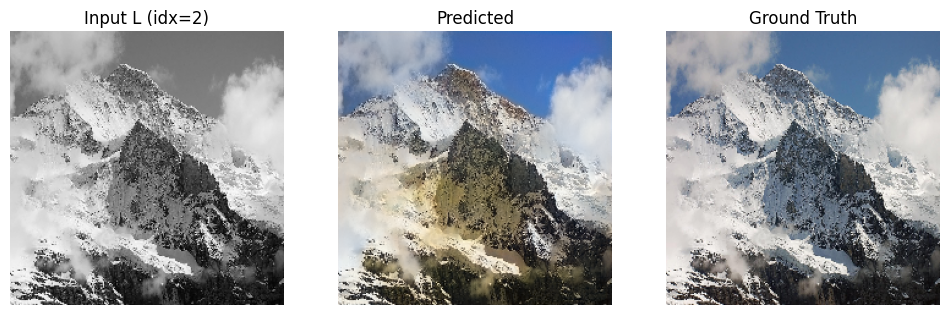

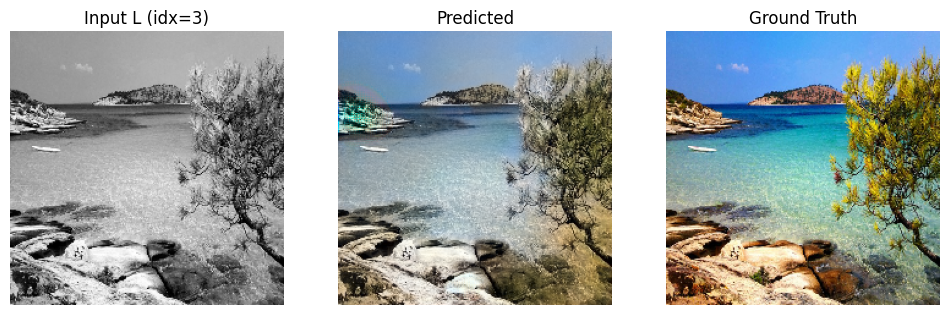

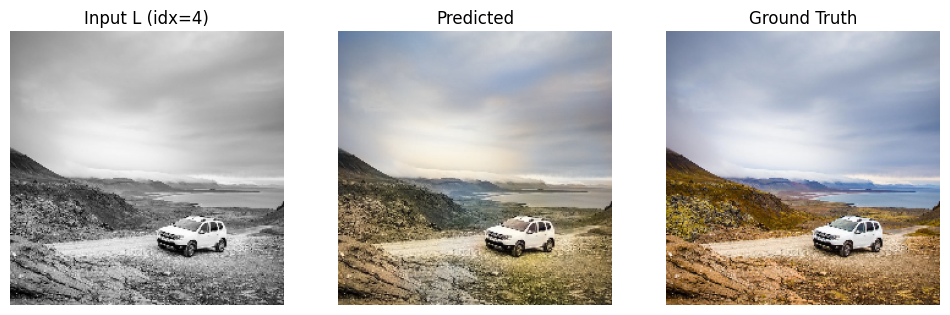

...

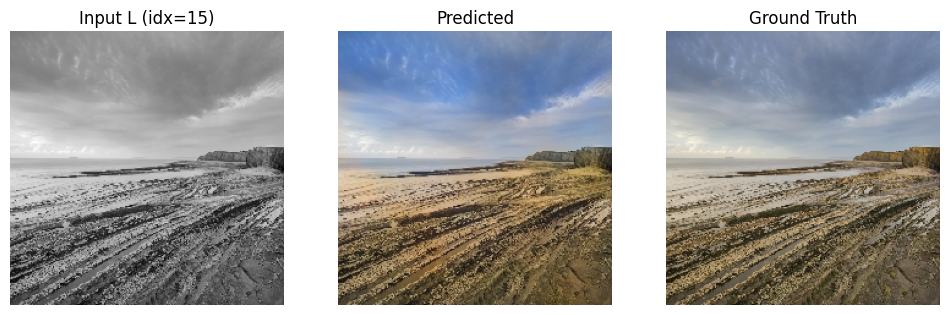

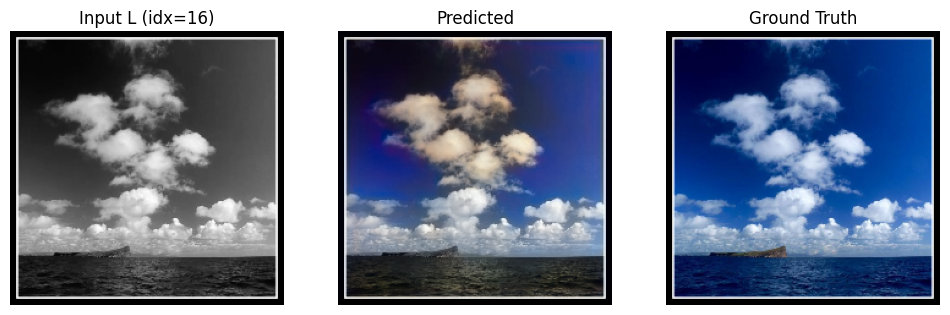

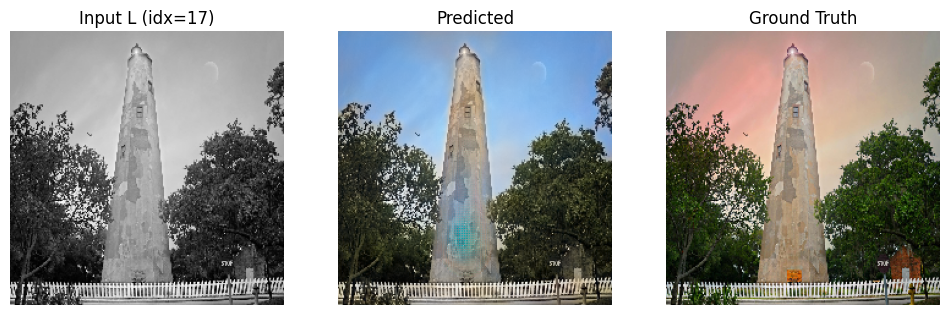

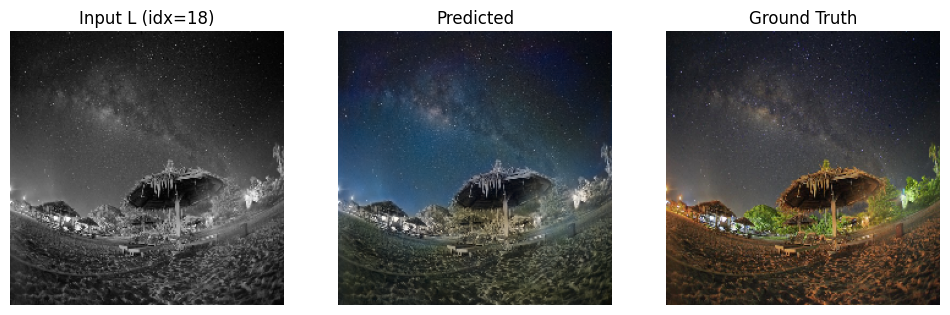

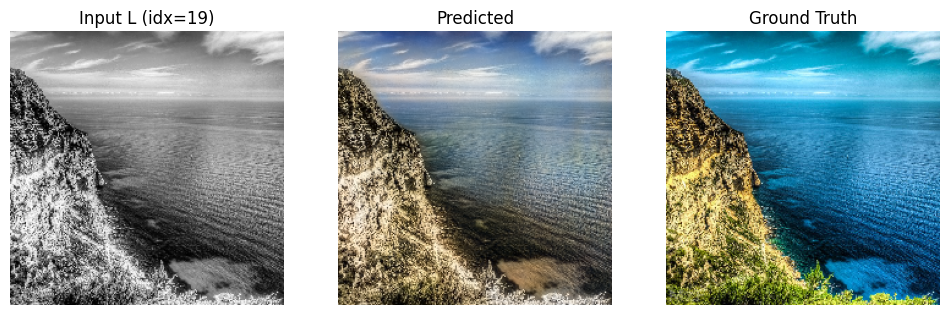

In [17]:
for i in range(20):
  visualize_image(model, val_ds, i)

In [ ]:
model_path = os.path.join(DRIVE_DIR, "pretraining4.pth")
torch.save(model.state_dict(), model_path)
print(f"✅ Model saved to Drive: {model_path}")

✅ Model saved to Drive: /content/drive/MyDrive/colorization_models/pretraining4.pth


In [18]:
def test_model(model, test_loader, device=DEVICE):
    model.eval()

    psnr_metric = PeakSignalNoiseRatio().to(device)
    ssim_metric = StructuralSimilarityIndexMeasure(data_range=1.0).to(device)
    mae_metric  = MeanAbsoluteError().to(device)

    psnr_metric.reset()
    ssim_metric.reset()
    mae_metric.reset()

    lpips_metric = lpips.LPIPS(net='alex').to(device)
    lpips_metric.eval()

    lpips_score = 0.0
    delta_e_score = 0.0
    n_samples = 0

    with torch.no_grad():
        for L, ab in test_loader:
            L, ab = L.to(device), ab.to(device)
            pred_ab = model(L)

            lab_pred = torch.cat([L * 100.0, pred_ab * (128.0 / AB_SCALE)], dim=1)
            lab_gt   = torch.cat([L * 100.0, ab * (128.0 / AB_SCALE)], dim=1)

            rgb_pred = lab_to_rgb(lab_pred).clamp(0, 1)
            rgb_gt   = lab_to_rgb(lab_gt).clamp(0, 1)

            batch_size = L.size(0)
            n_samples += batch_size

            psnr_metric.update(rgb_pred, rgb_gt)
            ssim_metric.update(rgb_pred, rgb_gt)
            mae_metric.update(rgb_pred, rgb_gt)

            lpips_score += lpips_metric(
                rgb_pred * 2 - 1,
                rgb_gt * 2 - 1
            ).sum().item()

            delta_e_score += delta_e(rgb_pred, rgb_gt).item() * batch_size

    print("✅ Test Results:")
    print(f"PSNR  : {psnr_metric.compute():.2f}")
    print(f"SSIM  : {ssim_metric.compute():.4f}")
    print(f"MAE   : {mae_metric.compute():.4f}")
    print(f"LPIPS : {lpips_score / n_samples:.4f}")
    print(f"ΔE    : {delta_e_score / n_samples:.2f}")

In [19]:
# After all training phases are done
test_model(model, test_loader, device=DEVICE)

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /usr/local/lib/python3.12/dist-packages/lpips/weights/v0.1/alex.pth
✅ Test Results:
PSNR  : 31.12
SSIM  : 0.9235
MAE   : 0.0499
LPIPS : 0.1627
ΔE    : 13.68


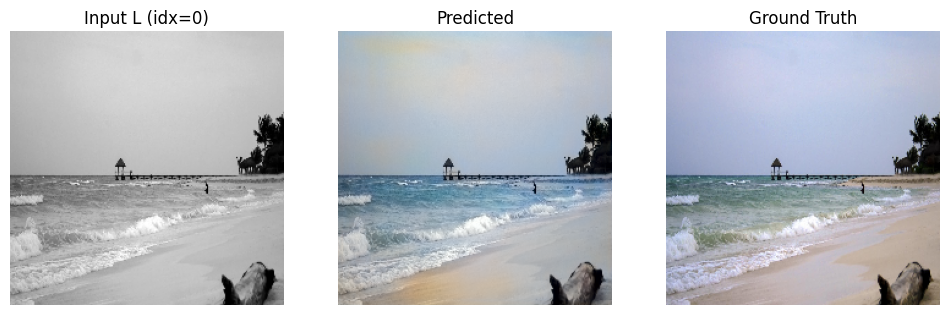

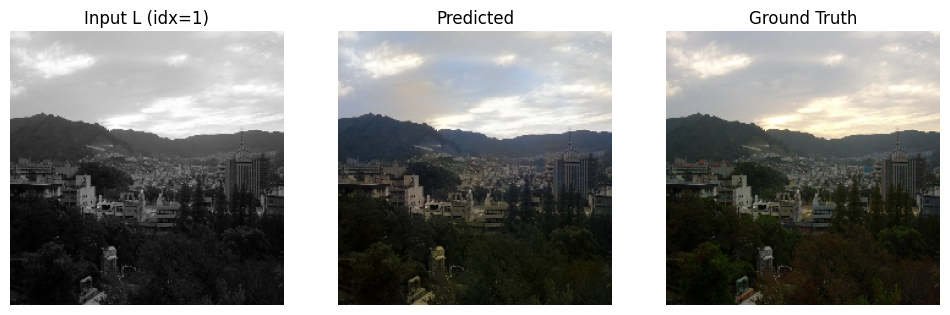

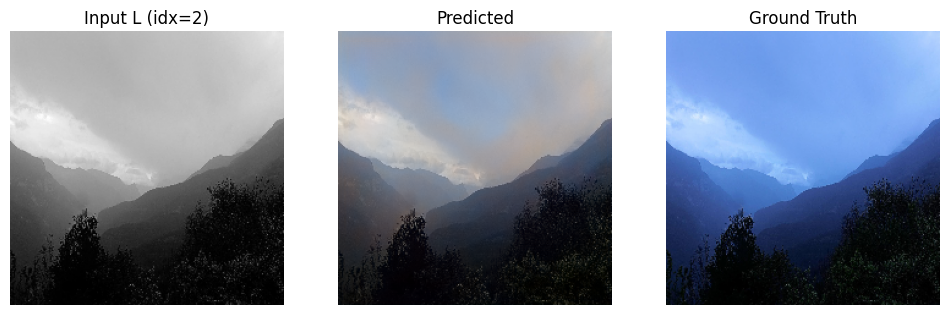

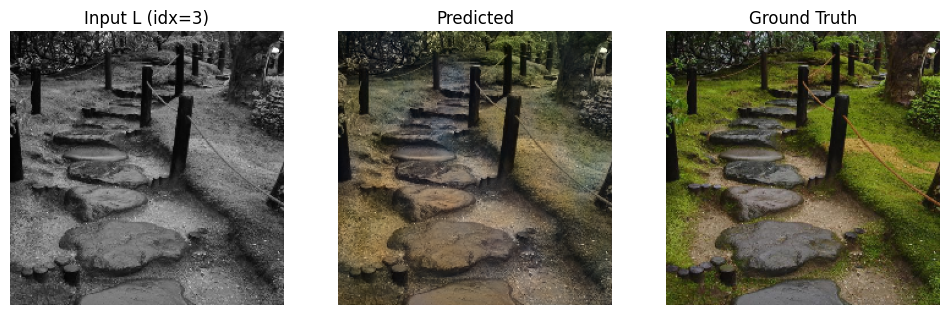

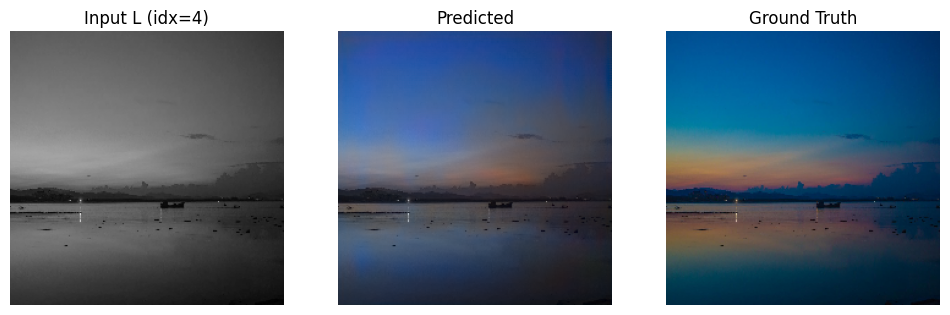

...

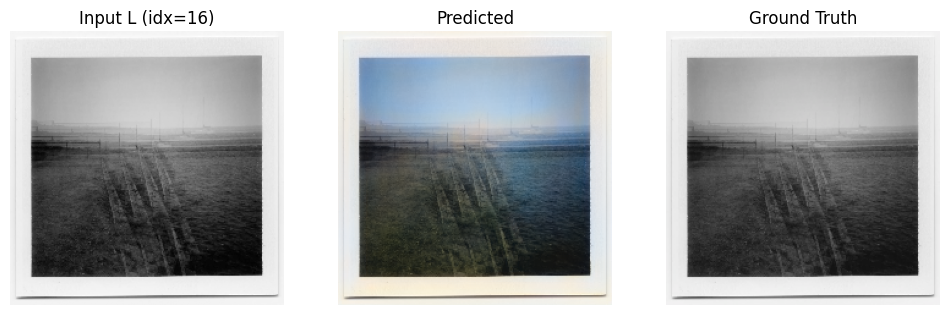

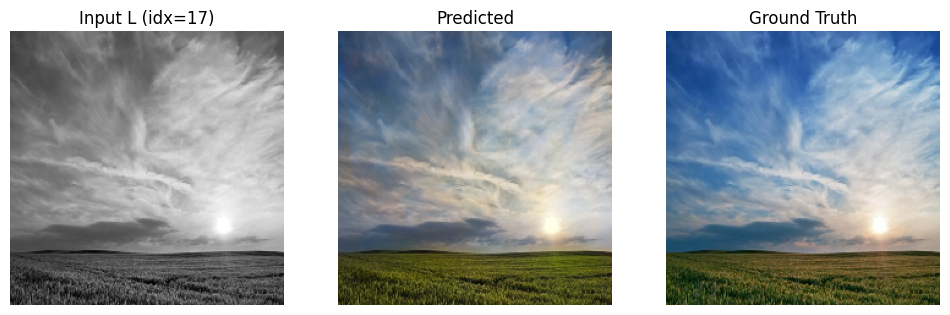

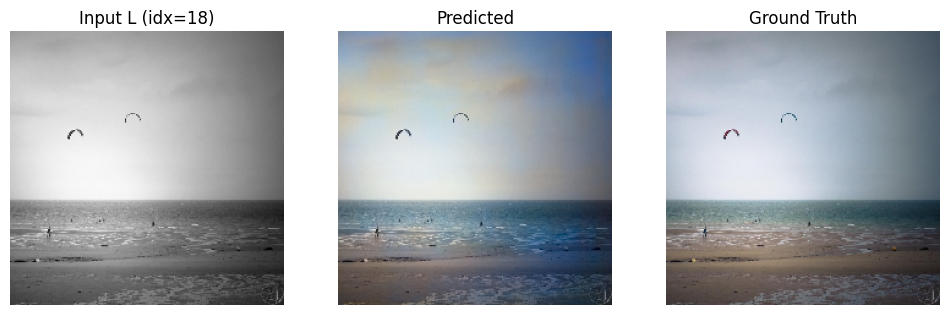

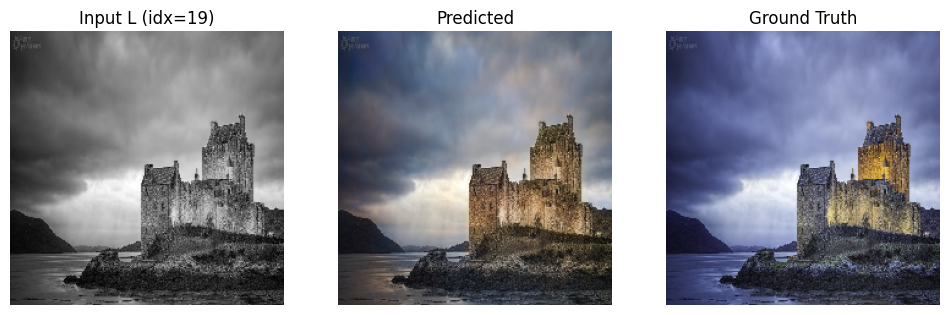

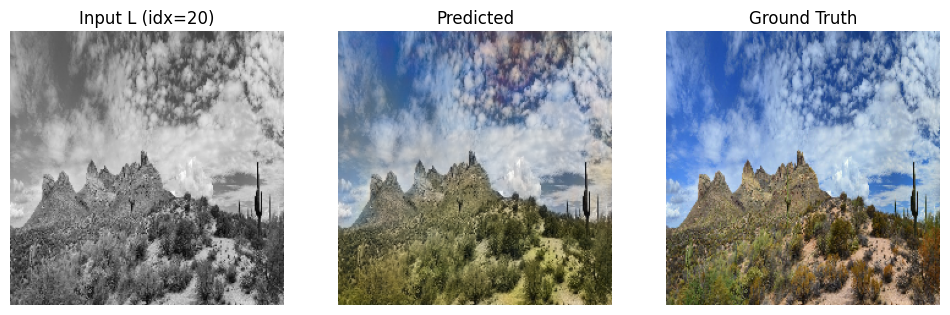

In [ ]:
for i in range(50):
  visualize_image(model, test_ds, i)

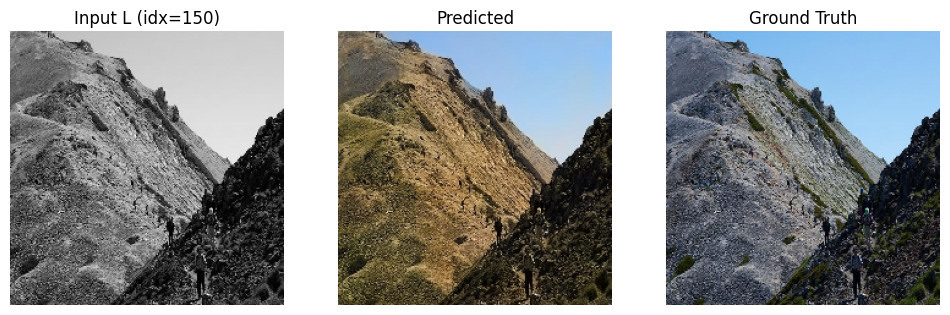

In [21]:
visualize_image(model, test_ds, 150)